# A Detailed Look


A Detailed Look at spatial interpolation, temporal integration, and input/output.
For additional documentation e.g. see :
[1](https://JuliaClimate.github.io/IndividualDisplacements.jl/dev/),
[2](https://JuliaClimate.github.io/MeshArrays.jl/dev/),
[3](https://docs.juliadiffeq.org/latest/solvers/ode_solve.html),
[4](https://en.wikipedia.org/wiki/Displacement_(vector))

In this example we :

- put together `uvetc` dictionnary
  - read gridded velocity output (U*data, V*data)
  - read trajectory output (`float_traj*data`)
- interpolate `U,V` along trajectory from gridded output
  - compare with `u,v` from `float_traj*data`
- compute whole trajectory using `OrdinaryDiffEq.jl`
  - compare with `x(t),y(t)` from `float_traj*data`

## 1. Import Software

In [1]:
using IndividualDisplacements, OrdinaryDiffEq
p=dirname(pathof(IndividualDisplacements))
include(joinpath(p,"../examples/recipes_plots.jl"))
include(joinpath(p,"../examples/example123.jl"))
include(joinpath(p,"../examples/helper_functions.jl"));

## 2. Read Trajectory Output

from `MITgcm/pkg/flt`

Cloning into '/home/travis/build/JuliaClimate/IndividualDisplacements.jl/src/../examples/flt_example'...
# floats=300
# steps=3000


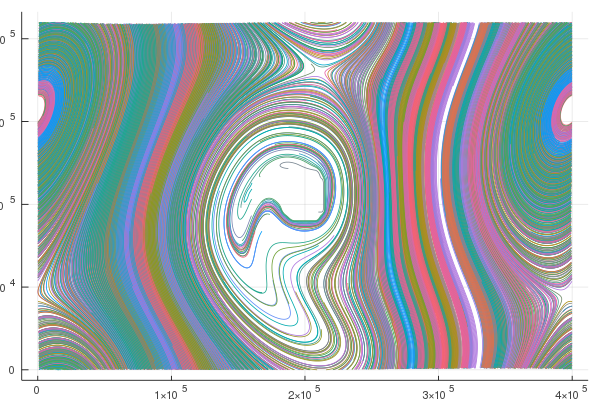

In [2]:
get_flt_ex_if_needed()
dirIn=joinpath(p,"../examples/flt_example/")
prec=Float32
df=read_flt(dirIn,prec) #function exported by IndividualDisplacements
plt=PlotBasic(df,300,100000.0)

## 3. Read Gridded Variables

via `MeshArrays.jl` and into a dictionary

In [3]:
uvetc=example2_setup()

Dict{String,Any} with 13 entries:
  "t0"   => 0.0
  "YC"   =>   data type   = Float32…
  "v1"   =>   data type   = Float64…
  "mskW" =>   data type   = Float64…
  "dx"   => 5000.0
  "u1"   =>   data type   = Float64…
  "XG"   =>   data type   = Float32…
  "YG"   =>   data type   = Float32…
  "u0"   =>   data type   = Float64…
  "mskS" =>   data type   = Float64…
  "t1"   => 6.48036e7
  "XC"   =>   data type   = Float32…
  "v0"   =>   data type   = Float64…

## 4. Visualize Velocity Fields

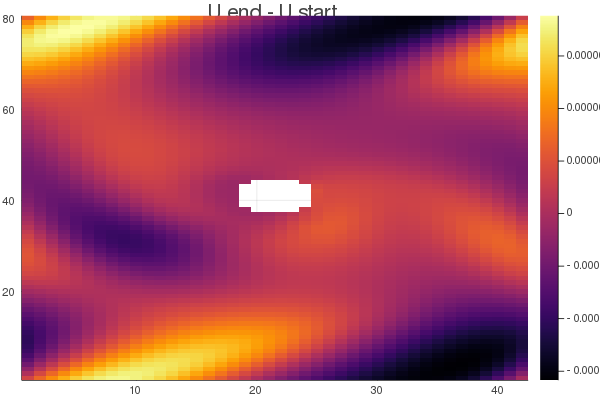

In [4]:
plt=heatmap(uvetc["mskW"][1,1].*uvetc["u0"][1,1],title="U at the start")

plt=heatmap(uvetc["mskW"][1,1].*uvetc["u1"][1,1]-uvetc["u0"][1,1],title="U end - U start")

## 5. Visualize Trajectories

(select one trajectory)

In [5]:
tmp=df[df.ID .== 200, :]
tmp[1:4,:]

,ID,time,lon,lat,dep,i,j,k,etaN
,Int64,Int64,Float32,Float32,Float32,Float32,Float32,Float32,Float32
1,200,3600,187630.0,21119.0,-1406.25,38.026,4.72379,3.0,0.114312
2,200,7200,1.87491e5,21155.8,-1406.25,37.9982,4.73115,3.0,0.114318
3,200,10800,1.87351e5,21193.1,-1406.25,37.9702,4.73861,3.0,0.114313
4,200,14400,1.87211e5,21230.9,-1406.25,37.9422,4.74619,3.0,0.11431


Super-impose trajectory over velocity field (first for u ...)

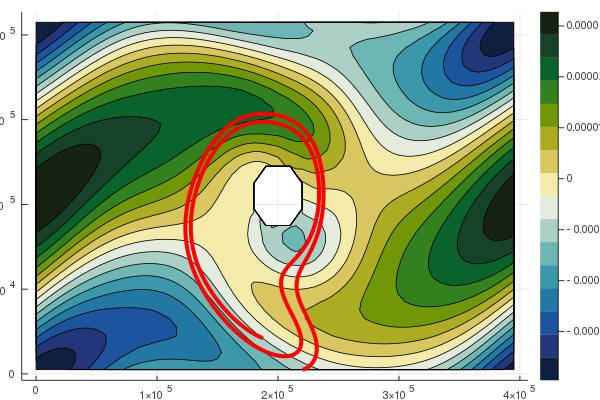

In [6]:
x=uvetc["XG"].f[1][:,1]
y=uvetc["YC"].f[1][1,:]
z=transpose(uvetc["mskW"][1].*uvetc["u0"][1,1])
plt=contourf(x,y,z,c=:delta)
plot!(tmp[:,:lon],tmp[:,:lat],c=:red,w=4,leg=false)

Super-impose trajectory over velocity field (... then for v)

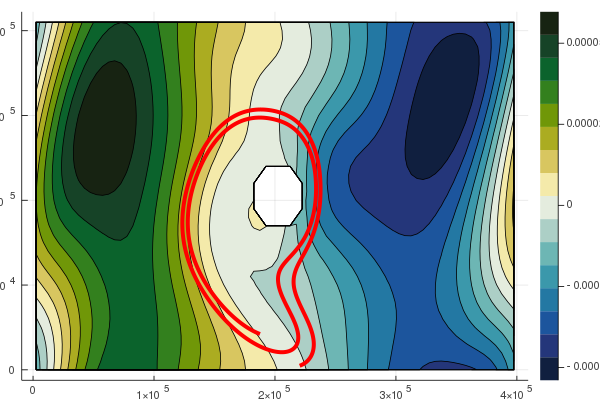

In [7]:
x=uvetc["XC"].f[1][:,1]
y=uvetc["YG"].f[1][1,:]
z=transpose(uvetc["mskW"][1].*uvetc["v0"][1,1])
plt=contourf(x,y,z,c=:delta)
plot!(tmp[:,:lon],tmp[:,:lat],c=:red,w=4,leg=false)

## 6. Interpolate Velocities

In [8]:
uInit=[tmp[1,:lon];tmp[1,:lat]]./uvetc["dx"]
nSteps=Int32(tmp[end,:time]/3600)-2
du=fill(0.0,2);

Visualize and compare with actual grid point values -- jumps on the tangential component are expected with linear scheme:

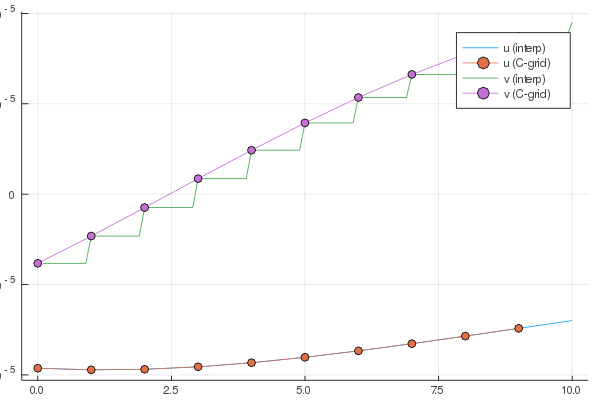

In [9]:
tmpu=fill(0.0,100)
tmpv=fill(0.0,100)
tmpx=fill(0.0,100)
for i=1:100
    tmpx[i]=500.0 *i./uvetc["dx"]
    ⬡(du,[tmpx[i];0.499./uvetc["dx"]],uvetc,0.0)
    tmpu[i]=du[1]
    tmpv[i]=du[2]
end
plt=plot(tmpx,tmpu,label="u (interp)")
plot!(uvetc["XG"].f[1][1:10,1]./uvetc["dx"],uvetc["u0"].f[1][1:10,1],marker=:o,label="u (C-grid)")
plot!(tmpx,tmpv,label="v (interp)")
plot!(uvetc["XG"].f[1][1:10,1]./uvetc["dx"],uvetc["v0"].f[1][1:10,1],marker=:o,label="v (C-grid)")

And similarly in the other direction

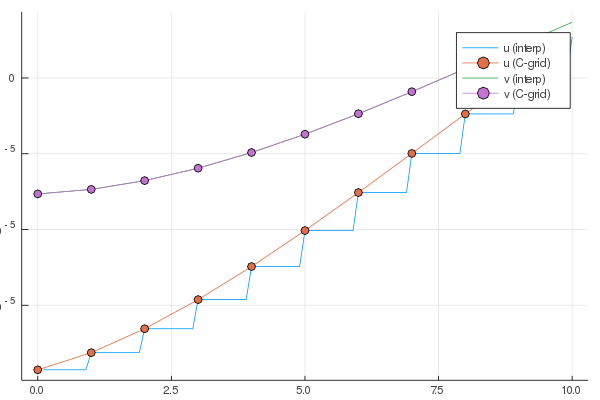

In [10]:
tmpu=fill(0.0,100)
tmpv=fill(0.0,100)
tmpy=fill(0.0,100)
for i=1:100
    tmpy[i]=500.0 *i./uvetc["dx"]
    ⬡(du,[0.499./uvetc["dx"];tmpy[i]],uvetc,0.0)
    tmpu[i]=du[1]
    tmpv[i]=du[2]
end
plt=plot(tmpx,tmpu,label="u (interp)")
plot!(uvetc["YG"].f[1][1,1:10]./uvetc["dx"],uvetc["u0"].f[1][1,1:10],marker=:o,label="u (C-grid)")
plot!(tmpx,tmpv,label="v (interp)")
plot!(uvetc["YG"].f[1][1,1:10]./uvetc["dx"],uvetc["v0"].f[1][1,1:10],marker=:o,label="v (C-grid)")

Compare recomputed velocities with those from `pkg/flt`

In [11]:
nSteps=2998
tmpu=fill(0.0,nSteps); tmpv=fill(0.0,nSteps);
tmpx=fill(0.0,nSteps); tmpy=fill(0.0,nSteps);
refu=fill(0.0,nSteps); refv=fill(0.0,nSteps);
for i=1:nSteps
    dxy_dt_replay(du,[tmp[i,:lon],tmp[i,:lat]],tmp,tmp[i,:time])
    refu[i]=du[1]./uvetc["dx"]
    refv[i]=du[2]./uvetc["dx"]
    ⬡(du,[tmp[i,:lon],tmp[i,:lat]]./uvetc["dx"],uvetc,tmp[i,:time])
    tmpu[i]=du[1]
    tmpv[i]=du[2]
end

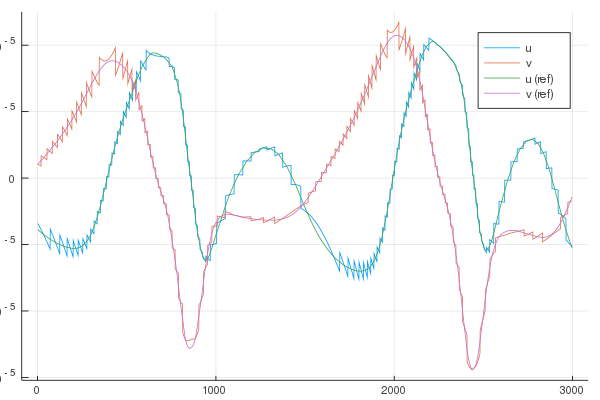

In [12]:
plt=plot(tmpu,label="u")
plot!(tmpv,label="v")
plot!(refu,label="u (ref)")
plot!(refv,label="v (ref)")

## 6. Compute Trajectories

Solve through time using `OrdinaryDiffEq.jl` with

- `⬡` is the function computing `du/dt`
- `uInit` is the initial condition `u @ tspan[1]`
- `tspan` is the time interval
- `uvetc` are parameters for `⬡`
- `Tsit5` is the time-stepping scheme
- `reltol` and `abstol` are tolerance parameters

In [13]:
tspan = (0.0,nSteps*3600.0)
#prob = ODEProblem(dxy_dt_replay,uInit,tspan,tmp)
prob = ODEProblem(⬡,uInit,tspan,uvetc)
sol = solve(prob,Tsit5(),reltol=1e-8,abstol=1e-8)
sol[1:4]

retcode: Success
Interpolation: specialized 4th order "free" interpolation
t: 4-element Array{Float64,1}:
  0.0               
  0.2007818920948153
  2.2086008130429686
 22.2867900225245   
u: 4-element Array{Array{Float64,1},1}:
 [37.525990625, 4.22379453125]         
 [37.52598925375626, 4.223794946058778]
 [37.52597554129228, 4.223799094139329]
 [37.5258384139952, 4.223840574222589] 

Compare recomputed trajectories with originals from `MITgcm/pkg/flt`

(2, 2998)

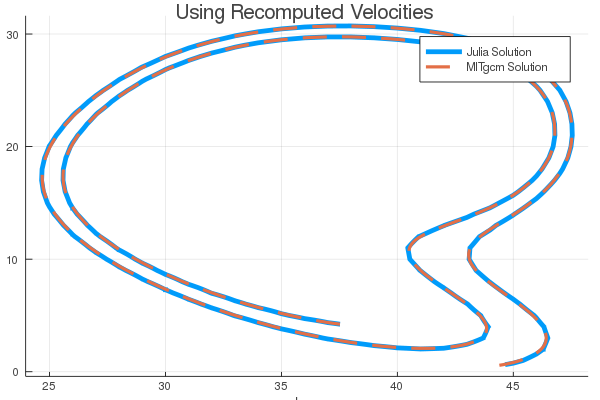

In [14]:
ref=transpose([tmp[1:nSteps,:lon] tmp[1:nSteps,:lat]])
maxLon=80*5.e3
maxLat=42*5.e3
show(size(ref))
for i=1:nSteps-1
    ref[1,i+1]-ref[1,i]>maxLon/2 ? ref[1,i+1:end]-=fill(maxLon,(nSteps-i)) : nothing
    ref[1,i+1]-ref[1,i]<-maxLon/2 ? ref[1,i+1:end]+=fill(maxLon,(nSteps-i)) : nothing
    ref[2,i+1]-ref[2,i]>maxLat/2 ? ref[2,i+1:end]-=fill(maxLat,(nSteps-i)) : nothing
    ref[2,i+1]-ref[2,i]<-maxLat/2 ? ref[2,i+1:end]+=fill(maxLat,(nSteps-i)) : nothing
end
ref=ref./uvetc["dx"]

plt=plot(sol[1,:],sol[2,:],linewidth=5,title="Using Recomputed Velocities",
     xaxis="lon",yaxis="lat",label="Julia Solution") # legend=false
plot!(ref[1,:],ref[2,:],lw=3,ls=:dash,label="MITgcm Solution")

---

*This notebook was generated using [Literate.jl](https://github.com/fredrikekre/Literate.jl).*